In [1]:
from plotnine import * 
import anndata as ad
import matplotlib as mpl
import matplotlib.pyplot as plt 
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns

sc.set_figure_params(figsize=(5,4), vector_friendly=False)
from pandas.api.types import CategoricalDtype


## merge samples

In [2]:
samp1 = sc.read_h5ad("lcmv_SNH1.h5ad")
samp3 = sc.read_h5ad("lcmv_SNH3.h5ad")
samp4 = sc.read_h5ad("lcmv_SNH4.h5ad")

In [3]:
samp1.obs["sample_lane"] = "SNH1"
samp3.obs["sample_lane"] = "SNH3"
samp4.obs["sample_lane"] = "SNH4"

In [4]:
merged = sc.concat([samp1, samp3, samp4])
merged.layers

/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


Layers with keys: raw_counts, theta_1

In [5]:
merged.obs

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_genes,likely sample,biotin_interaction,biotin_donor,biotin sample,sample count,cell_norm_biotin,cell_norm_donor,sample_lane
AAACCTGAGCGAAGGG-1,2463,7152.0,30.0,0.419463,2456,M16_biotin,70.0,24.0,True,3835.0,0.018253,0.006258,SNH1
AAACCTGCAAATCCGT-1,2227,6617.0,104.0,1.571709,2224,M6,2.0,2.0,False,2846.0,0.000703,0.000703,SNH1
AAACCTGCAAGTTGTC-1,2088,7118.0,79.0,1.109862,2084,M14_biotin,84.0,8.0,True,419.0,0.200477,0.019093,SNH1
AAACCTGCAATGGAGC-1,3868,17145.0,294.0,1.714786,3857,M16_biotin,22.0,1.0,True,1020.0,0.021569,0.000980,SNH1
AAACCTGCACCAGTTA-1,1779,4811.0,54.0,1.122428,1775,M16_biotin,40.0,3.0,True,1127.0,0.035492,0.002662,SNH1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCACTTCAT-1,5568,36272.0,542.0,1.494266,5562,Lu2_biotin,342.0,140.0,True,221.0,1.547511,0.633484,SNH4
TTTGTCATCCAAACTG-1,1414,3513.0,39.0,1.110162,1411,S1,10.0,6.0,False,1519.0,0.006583,0.003950,SNH4
TTTGTCATCCACTCCA-1,1487,6212.0,8.0,0.128783,1484,Lu3,17.0,2.0,False,655.0,0.025954,0.003053,SNH4
TTTGTCATCGCGATCG-1,1398,5396.0,5.0,0.092661,1396,Lu1,4.0,4.0,False,2095.0,0.001909,0.001909,SNH4


In [6]:
merged.obs

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_genes,likely sample,biotin_interaction,biotin_donor,biotin sample,sample count,cell_norm_biotin,cell_norm_donor,sample_lane
AAACCTGAGCGAAGGG-1,2463,7152.0,30.0,0.419463,2456,M16_biotin,70.0,24.0,True,3835.0,0.018253,0.006258,SNH1
AAACCTGCAAATCCGT-1,2227,6617.0,104.0,1.571709,2224,M6,2.0,2.0,False,2846.0,0.000703,0.000703,SNH1
AAACCTGCAAGTTGTC-1,2088,7118.0,79.0,1.109862,2084,M14_biotin,84.0,8.0,True,419.0,0.200477,0.019093,SNH1
AAACCTGCAATGGAGC-1,3868,17145.0,294.0,1.714786,3857,M16_biotin,22.0,1.0,True,1020.0,0.021569,0.000980,SNH1
AAACCTGCACCAGTTA-1,1779,4811.0,54.0,1.122428,1775,M16_biotin,40.0,3.0,True,1127.0,0.035492,0.002662,SNH1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCACTTCAT-1,5568,36272.0,542.0,1.494266,5562,Lu2_biotin,342.0,140.0,True,221.0,1.547511,0.633484,SNH4
TTTGTCATCCAAACTG-1,1414,3513.0,39.0,1.110162,1411,S1,10.0,6.0,False,1519.0,0.006583,0.003950,SNH4
TTTGTCATCCACTCCA-1,1487,6212.0,8.0,0.128783,1484,Lu3,17.0,2.0,False,655.0,0.025954,0.003053,SNH4
TTTGTCATCGCGATCG-1,1398,5396.0,5.0,0.092661,1396,Lu1,4.0,4.0,False,2095.0,0.001909,0.001909,SNH4


## learning time, WT/mutant LCMV from mouse info

In [7]:
def get_sample_info(samp):
    s = samp.split("_")[0]
    infection = "WT"
    if s in ["M4", "M9", "M14", "Li4", "Li5", "Lu5", "S4", "S5", "Lu4" ]:
        infection = "Mut"
    time = "96h"
    if s in ["M6", "M9", "M16", "M8"]:
        time = "50h"
    elif s in ["M11", "M13", "M14"]:
        time = "36hr"
    return infection, time
merged.obs["timepoint"] = [ get_sample_info(s)[1] for s in merged.obs["likely sample"]]
merged.obs["infection"] = [ get_sample_info(s)[0] for s in merged.obs["likely sample"]]
samp_labels = lambda s: "MedLN" if s.startswith("M") else "Liver" if s.startswith("Li") else "Lung" if s.startswith(
"Lu") else "Spleen"
merged.obs["sample origin"] = [ samp_labels(s) for s in merged.obs["likely sample"]]

In [8]:
merged.obs

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_genes,likely sample,biotin_interaction,biotin_donor,biotin sample,sample count,cell_norm_biotin,cell_norm_donor,sample_lane,timepoint,infection,sample origin
AAACCTGAGCGAAGGG-1,2463,7152.0,30.0,0.419463,2456,M16_biotin,70.0,24.0,True,3835.0,0.018253,0.006258,SNH1,50h,WT,MedLN
AAACCTGCAAATCCGT-1,2227,6617.0,104.0,1.571709,2224,M6,2.0,2.0,False,2846.0,0.000703,0.000703,SNH1,50h,WT,MedLN
AAACCTGCAAGTTGTC-1,2088,7118.0,79.0,1.109862,2084,M14_biotin,84.0,8.0,True,419.0,0.200477,0.019093,SNH1,36hr,Mut,MedLN
AAACCTGCAATGGAGC-1,3868,17145.0,294.0,1.714786,3857,M16_biotin,22.0,1.0,True,1020.0,0.021569,0.000980,SNH1,50h,WT,MedLN
AAACCTGCACCAGTTA-1,1779,4811.0,54.0,1.122428,1775,M16_biotin,40.0,3.0,True,1127.0,0.035492,0.002662,SNH1,50h,WT,MedLN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCACTTCAT-1,5568,36272.0,542.0,1.494266,5562,Lu2_biotin,342.0,140.0,True,221.0,1.547511,0.633484,SNH4,96h,WT,Lung
TTTGTCATCCAAACTG-1,1414,3513.0,39.0,1.110162,1411,S1,10.0,6.0,False,1519.0,0.006583,0.003950,SNH4,96h,WT,Spleen
TTTGTCATCCACTCCA-1,1487,6212.0,8.0,0.128783,1484,Lu3,17.0,2.0,False,655.0,0.025954,0.003053,SNH4,96h,WT,Lung
TTTGTCATCGCGATCG-1,1398,5396.0,5.0,0.092661,1396,Lu1,4.0,4.0,False,2095.0,0.001909,0.001909,SNH4,96h,WT,Lung


## try filtering non-coding genes from GTF file:
```cat /Genomics/pritykinlab/share/uLIPSTIC/data/lcmv/cellranger_mm10_ref/refdata-gex-mm10-2020-A/genes/genes.gtf | grep "protein_coding" | sed 's/.* gene_name "//' | sed 's/";.*//' | uniq > cell_ranger_protein_coding_genes.csv```

In [9]:
coding_genes = pd.read_csv("cell_ranger_protein_coding_genes.csv", header = None)
coding_genes

,0
0,Xkr4
1,Rp1
2,Sox17
3,Mrpl15
4,Lypla1
...,...
21689,AC124606.1
21690,AC133095.2
21691,AC133095.1
21692,AC234645.1


In [10]:
filtered_merged = merged[:, merged.var_names.intersection(coding_genes[0])].copy()

/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


In [11]:
filtered_merged.shape

(27043, 11558)

## here, selecting only WT med LN cells:
do typical PCA, neighborhood, clustering on these cells

In [12]:
wt_medln = filtered_merged[(filtered_merged.obs["infection"] == "WT") & 
                          (filtered_merged.obs["sample origin"] == "MedLN")]
wt_medln.shape

(11846, 11558)

In [ ]:
sc.tl.pca(wt_medln, n_comps=100, svd_solver='arpack')

In [ ]:
sc.pl.pca_variance_ratio(wt_medln, 100, log=True, )

In [15]:
n_pcs = 50

## we like cosine similarity more so than Euclidean (better silhouettes once clustering)
sc.pp.neighbors(wt_medln, n_neighbors=30, n_pcs=n_pcs, use_rep='X_pca', metric="cosine")


2024-01-11 14:16:30.492063: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2024-01-11 14:16:30.492144: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory
2024-01-11 14:16:30.492150: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.


In [16]:
from sklearn.metrics import silhouette_score
silhouette_test = wt_medln.copy() # don't make actual adata ugly with tons of unnecessary cluster labels

def test_clustering(resolution, ad, num_pcs):
    leiden_key = "leiden_"+str(resolution)
    sc.tl.leiden(ad, resolution=resolution, key_added=leiden_key)
    return silhouette_score(ad.obsm["X_pca"][:, 0:num_pcs], labels = ad.obs[leiden_key], metric="cosine")

silhouette_scores = pd.DataFrame()
## range of 
for res in np.arange(0.2, 3.0, 0.1): 
    sil = test_clustering(res, silhouette_test, n_pcs)  ## same number PCs as used to build KNN graph
    silhouette_scores = pd.concat([silhouette_scores, pd.DataFrame({"resolution": [res], "silhouette": [sil]})])

silhouette_scores.head()

/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


,resolution,silhouette
0,0.2,0.358086
0,0.3,0.361553
0,0.4,0.332067
0,0.5,0.260898
0,0.6,0.252817


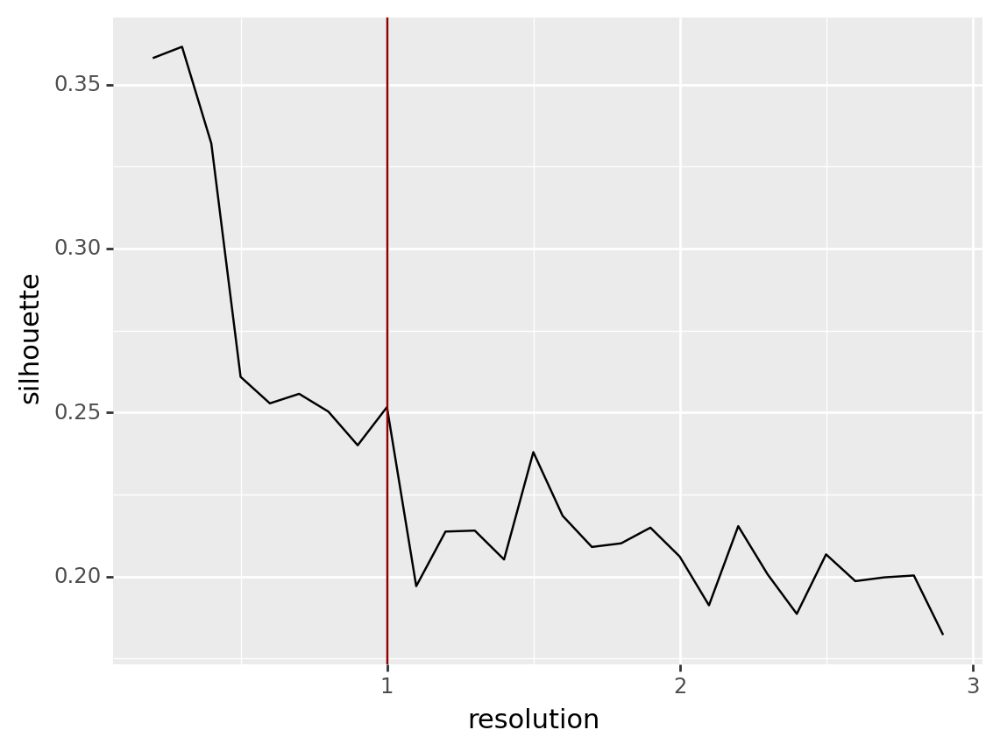

<ggplot: (8793456290681)>

In [17]:
ggplot(silhouette_scores, aes(x="resolution", y="silhouette")) + geom_line() + \
geom_vline(color="darkred", xintercept = 1) + labs(x="resolution")

In [18]:
sc.tl.leiden(wt_medln, resolution = 1)

In [19]:
sc.tl.umap(wt_medln)

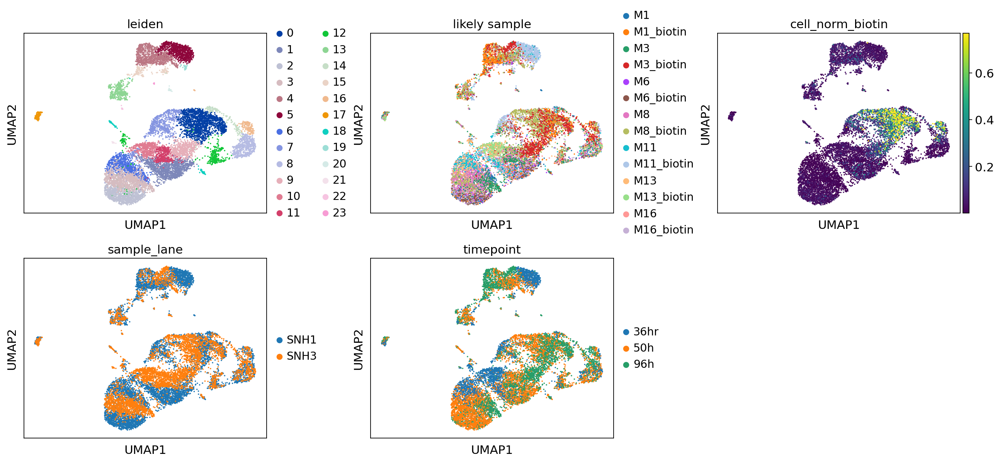

In [20]:
sc.pl.umap(wt_medln, color= ["leiden", "likely sample", "cell_norm_biotin", "sample_lane", "timepoint"], ncols = 3,
          vmin = "p2", vmax = "p98", wspace=0.3)

## <font color = "blue"> Extended Data Figure 14 Panel A

In [21]:
sc.set_figure_params(figsize=(5,5), transparent=False, dpi_save=200, vector_friendly=False)

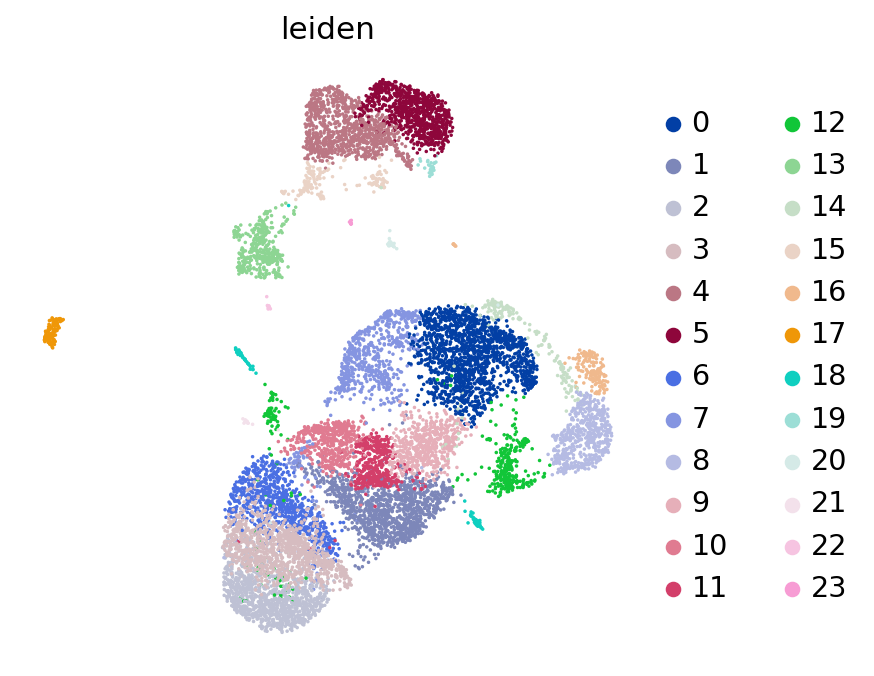

In [23]:
cmap = mpl.cm.get_cmap("magma_r")(np.linspace(0,1,30))
magma_cmap = mpl.colors.ListedColormap(cmap[2:,:-1])

sc.pl.umap(wt_medln, color = ["leiden"], layer="theta_1",  frameon = False,save = ".ln_leiden.pdf")


## colors used for samples:
- #EA1F27 (red)
- #0088BE (blue/teal)
- #004910 (dark green)

In [24]:
wt_medln.uns["timepoint_colors"] = ["#EA1F27", "#0088BE", "#004910"]

## <font color = "blue"> Extended Data Figure 14 Panel B, left

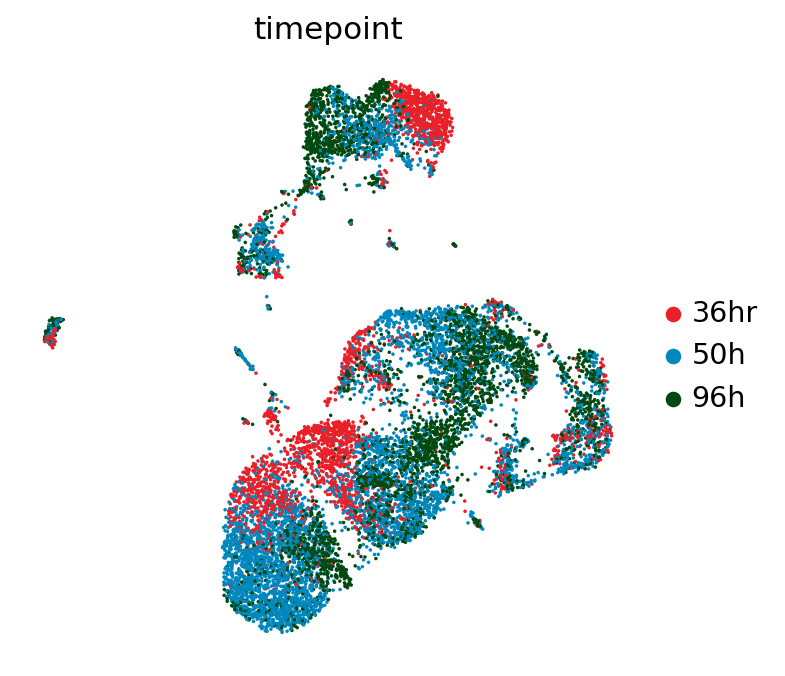

In [25]:
sc.pl.umap(wt_medln, color = "timepoint", cmap = magma_cmap, frameon = False,save = ".ln_timepoint.pdf")


In [26]:
## reorder so numbers go in correct direction
wt_medln.obs[" leiden "] = wt_medln.obs["leiden"].astype(pd.api.types.CategoricalDtype(
    wt_medln.obs["leiden"].cat.categories[::-1], ordered=True))

## <font color = "blue"> Extended Data Figure 14 Panel B, right

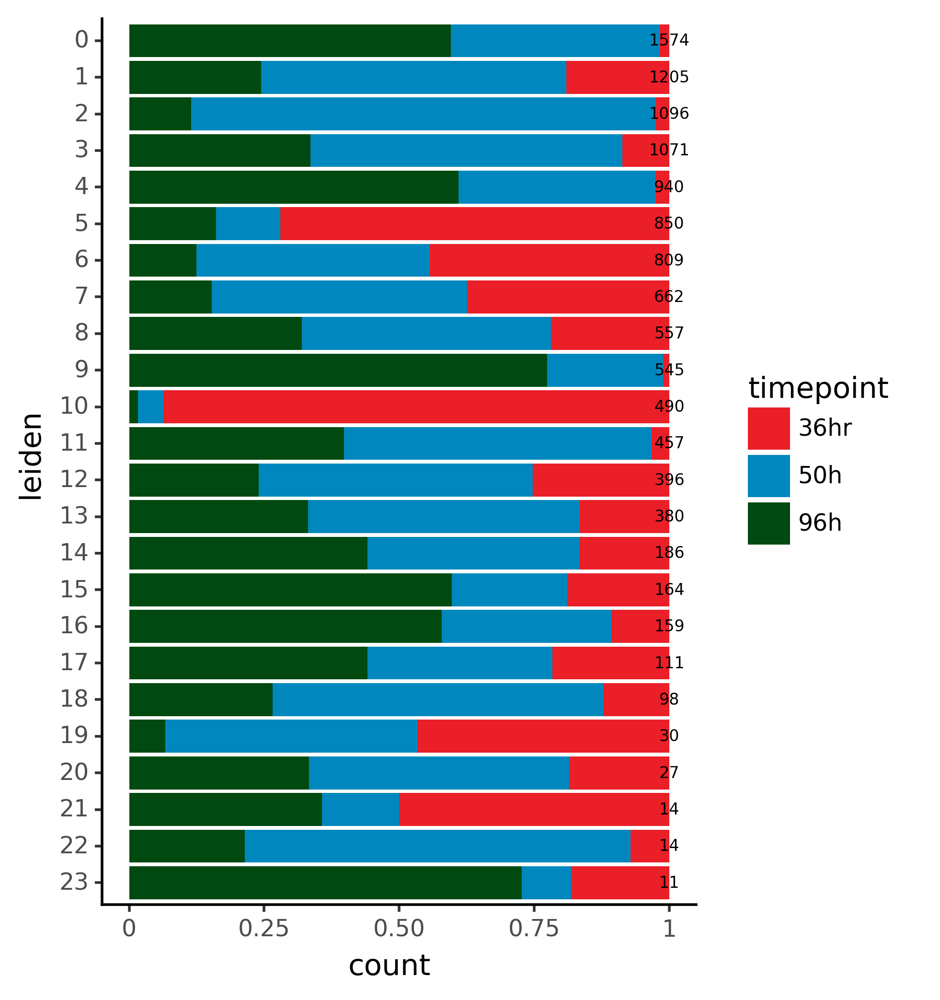

<ggplot: (8793457558276)>

In [27]:
timepoint_bar = ggplot(wt_medln.obs, aes(x=" leiden ", fill = "timepoint")) + geom_bar(position = "fill") + \
scale_fill_manual(wt_medln.uns["timepoint_colors"]) + theme_classic() + theme(dpi = 200, figure_size=(4,6)) + \
coord_flip() + geom_text(wt_medln.obs.groupby([" leiden "]).count().reset_index(), aes(
    x = " leiden ", label = "total_counts"), y = 1, color = "black", size = 6, inherit_aes = False) 
timepoint_bar

In [29]:
ggsave(timepoint_bar, "figures/barplot.ln_timepoint_composition.pdf", dpi = 200)

/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 4 x 6 in image.
/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/barplot.ln_timepoint_composition.pdf


In [30]:
wt_medln.obs["mouse"] = wt_medln.obs["likely sample"].str.split("_").str[0]

## <font color = "blue"> Extended Data Figure 14 Panel C, left

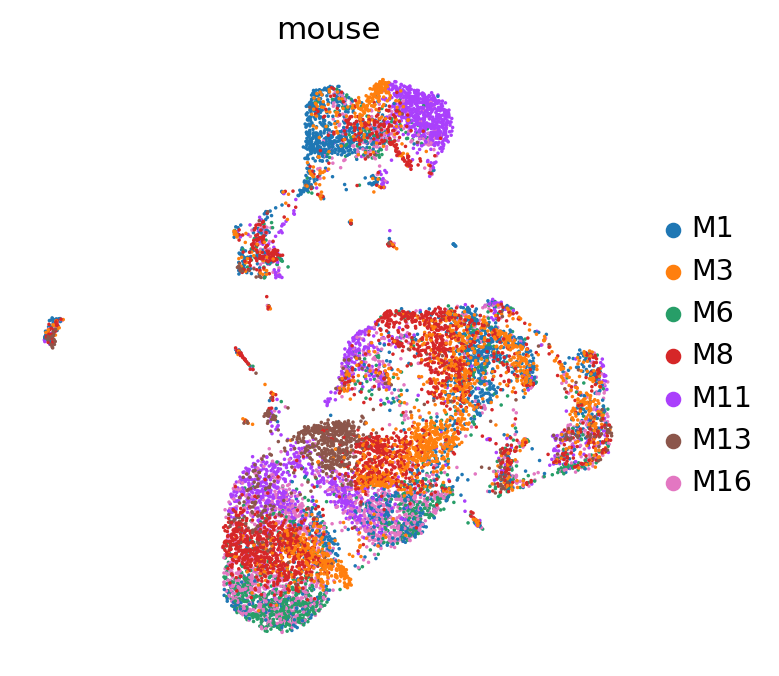

In [31]:
sc.pl.umap(wt_medln, color = "mouse", cmap = magma_cmap, frameon = False,save = ".ln_mouse.pdf")


In [33]:
wt_medln.obs["background"] = ["background" if not bs else "biotin + samp" for bs in wt_medln.obs["biotin sample"]]

## <font color = "blue"> Extended Data Figure 14 Panel C, right

/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 8 x 10 in image.
/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/barplot.ln_mouse_composition.pdf


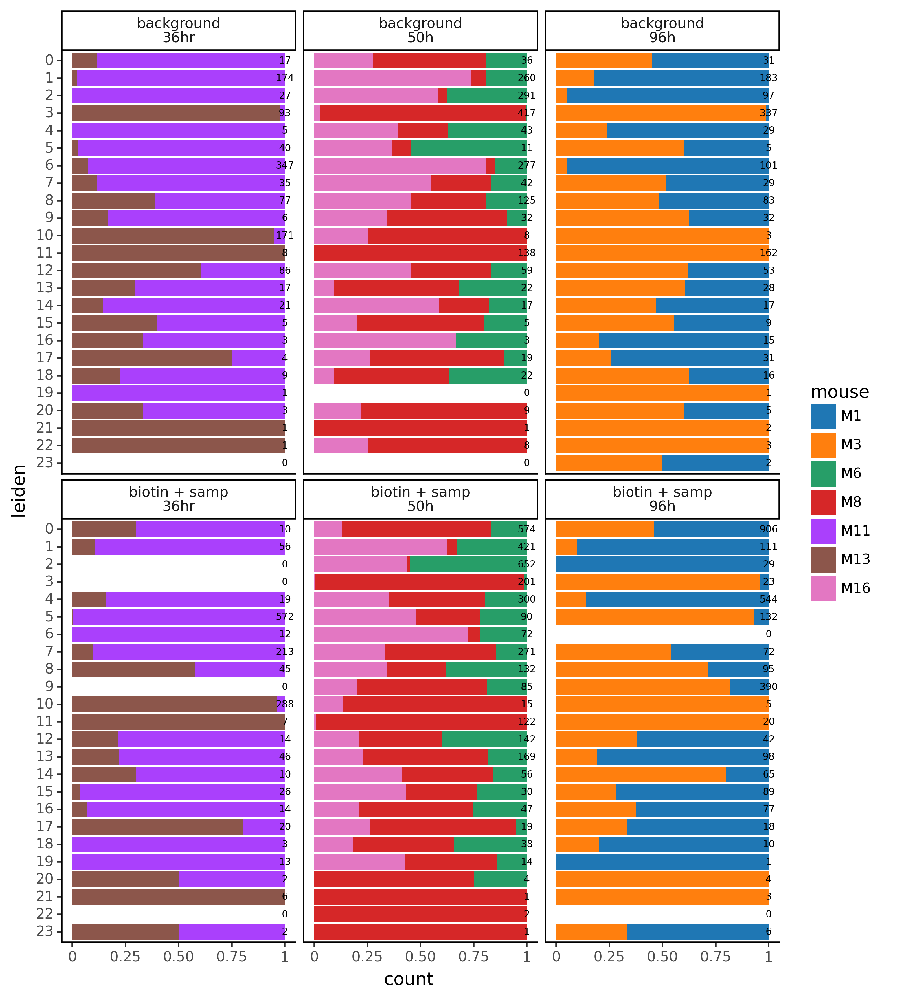

<ggplot: (8793401502263)>

In [34]:
mouse_barplot = ggplot(wt_medln.obs, aes(x=" leiden ", fill = "mouse")) + geom_bar(position = "fill") + \
scale_fill_manual(wt_medln.uns["mouse_colors"]) + theme_classic() + theme(dpi = 200, figure_size=(8, 10)) + \
coord_flip() + geom_text(wt_medln.obs.groupby(["timepoint", " leiden ", "background"]).count().reset_index(), aes(
        x = " leiden ", label = "total_counts"), y = 1, color = "black", size = 6, inherit_aes = False) + facet_wrap(
    "~ background + timepoint", drop = True) 
ggsave(mouse_barplot, "figures/barplot.ln_mouse_composition.pdf", dpi = 200)
mouse_barplot

## start annotating clusters

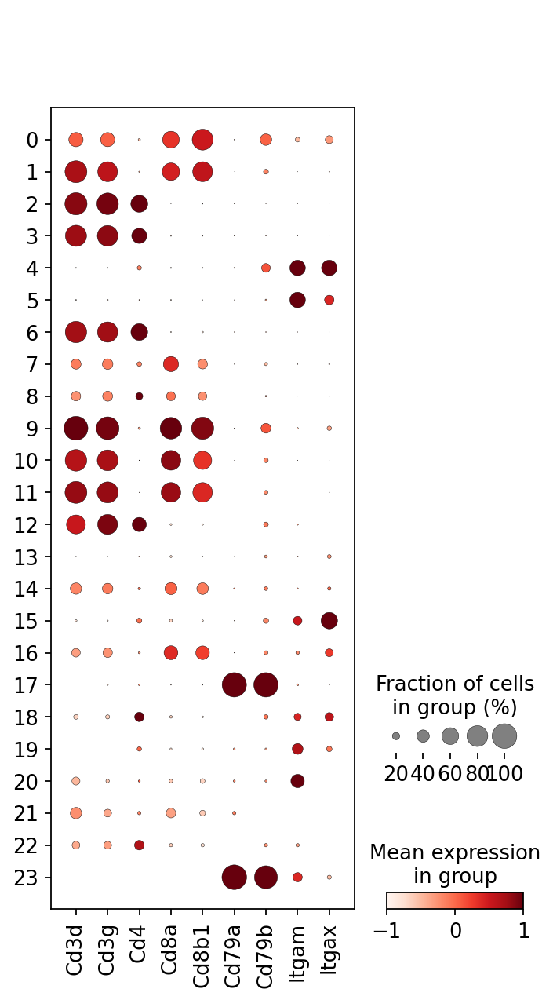

In [35]:
sc.pl.dotplot(wt_medln, var_names = ["Cd3d", "Cd3g", "Cd4", "Cd8a", "Cd8b1", "Cd79a", "Cd79b", "Itgam", "Itgax"], 
              groupby = "leiden", norm = mpl.colors.Normalize(vmin=-1, vmax=1))

## first draft annotations:
- T cells: 0-3, 6, 7?, 8, 9-12, 14?, 16?, 21? 22?
    - Cd8: 0, 1, 7, 9-11, 14, 16, 21?
    - Cd4:  2,3, 6, 8, 12, 22?
- B cells: 17, 23
- myeloid cells: 4, 5, 15, 18, 19, 20
- unknown: 13

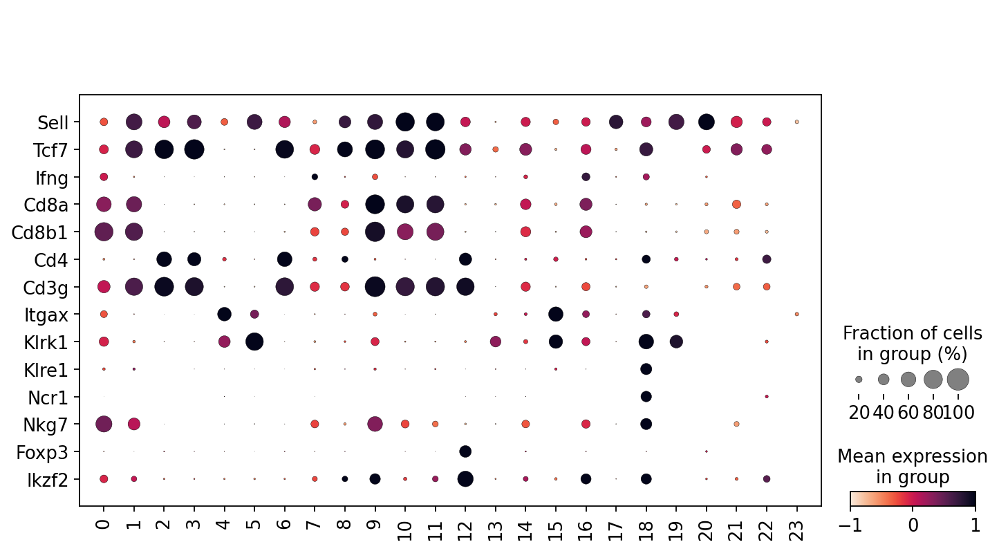

In [36]:
sc.pl.dotplot(wt_medln, var_names = [
    "Sell", "Tcf7", "Ifng", "Cd8a", "Cd8b1", "Cd4", "Cd3g", "Itgax", "Klrk1", "Klre1", "Ncr1", "Nkg7", 
    "Foxp3", "Ikzf2"
], 
              groupby="leiden", norm = mpl.colors.Normalize(vmin=-1, vmax=1), swap_axes = True,  
              cmap="rocket_r")

## updated annotations:
- T cells: 0-3, 6, 7?, 8, 9-12, 14?, 16?, 21? 22?
    - Cd8: 0, 1, 7, 9-11, 14, 16, 21?
        - more eff like: 0, 7??
    - Cd4:  2,3, 6, 8, 12, 22?
        - Treg: 12
- B cells: 17, 23
- myeloid cells: 4, 5, 15, 18, 19, 20
    - 18: NK
- unknown: 13

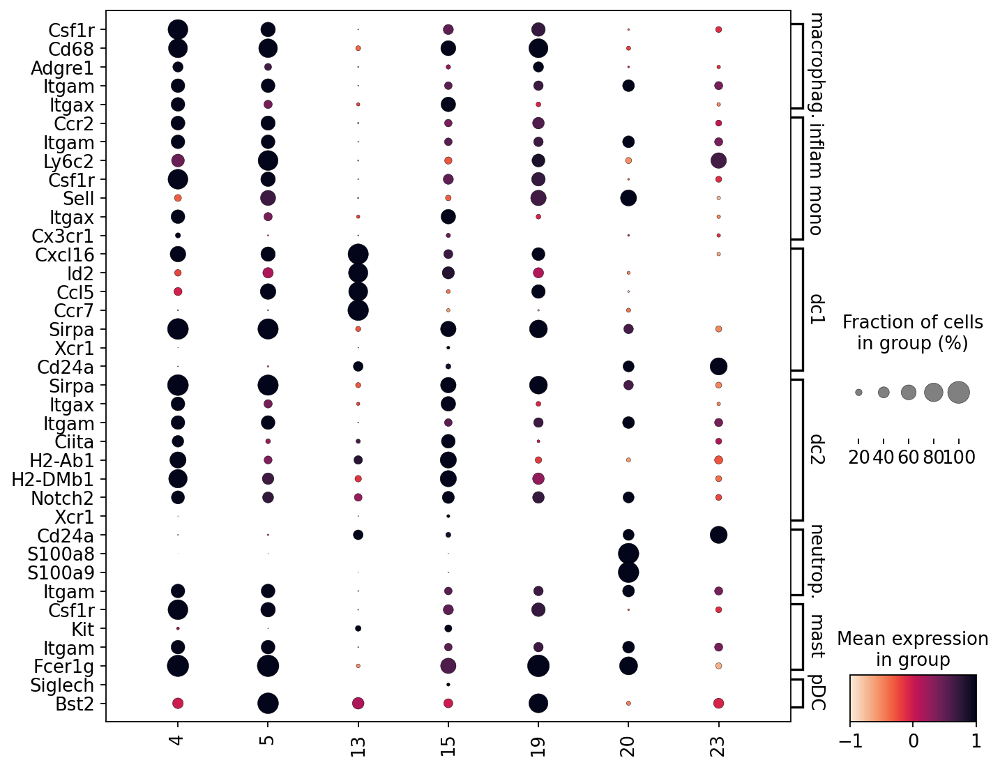

In [37]:
sc.pl.dotplot(wt_medln[wt_medln.obs.leiden.isin(["4", "5","15","19", "20", "13", "23"])], var_names = [
    "Csf1r", "Cd68", "Adgre1", "Itgam", "Itgax", # macrophage
    "Ccr2", "Itgam", "Ly6c2", "Csf1r", "Sell", "Itgax", "Cx3cr1",# inflam mono
    "Cxcl16", "Id2", "Ccl5", "Ccr7", "Sirpa", "Xcr1", "Cd24a",# dc1
    "Sirpa", "Itgax", "Itgam", "Ciita",  "H2-Ab1", "H2-DMb1", "Notch2", "Xcr1", "Cd24a", # dc2
    "S100a8", "S100a9", "Itgam", "Csf1r", # neutrophil
    "Kit", "Itgam", "Fcer1g", # mast?
    "Siglech", "Bst2"], # pDCs
              groupby="leiden", norm = mpl.colors.Normalize(vmin=-1, vmax=1), swap_axes = True,  
              cmap="rocket_r", figsize=(10, 8), var_group_labels=[
                  "macrophage", "inflam mono", "dc1", "dc2", "neutrophil", "mast", "pDC"], var_group_positions = [
                  (0,4), (5,11), (12,18), (19, 26), (27, 30), (31,34), (35, 36)])

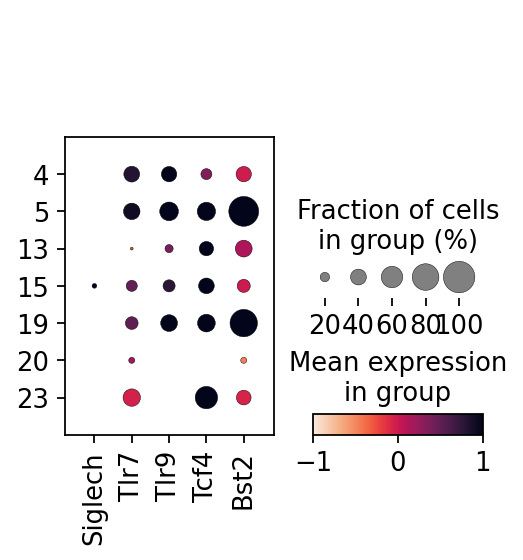

In [38]:
## pDCs
sc.pl.dotplot(wt_medln[wt_medln.obs.leiden.isin(["4", "5","15","19", "20", "13", "23"])], var_names = [
    "Siglech", "Tlr7", "Tlr9", "Tcf4", "Bst2"], cmap="rocket_r",
    groupby="leiden", norm = mpl.colors.Normalize(vmin=-1, vmax=1))

## updated annotations:
- T cells: 0-3, 6, 7?, 8, 9-12, 14?, 16?, 21? 22?
    - Cd8: 0, 1, 7, 9-11, 14, 16, 21?
        - more eff like: 0, 7??
    - Cd4:  2,3, 6, 8, 12, 22?
        - Treg: 12
- B cells: 17, 23
- myeloid cells: 4, 5, 15, 18, 19, 20
    - 4, 5: macrophage, monocyte
    - 13: DC1
    - 15: DC2
    - 18: NK
    - 20: neutrophil
    - 19: unsure


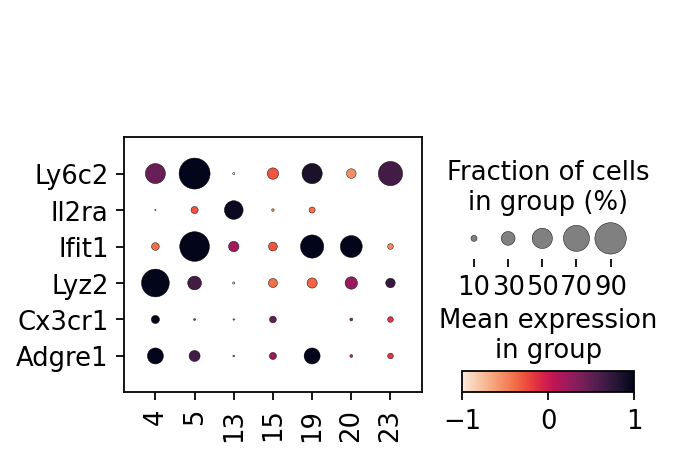

In [39]:
sc.pl.dotplot(wt_medln[wt_medln.obs["leiden"].isin(["4", "5","15","19", "20", "13", "23"])],
              var_names = ["Ly6c2", "Il2ra", "Ifit1", "Lyz2", "Cx3cr1", "Adgre1"], groupby="leiden",
             norm = mpl.colors.Normalize(vmin=-1, vmax=1), swap_axes = True,  cmap="rocket_r", layer = "theta_1")

In [40]:
def annot_cl(c):
    cl = int(c)
    if cl == 0:
        return "eff-like Cd8"
    if cl in [ 1, 7, 9, 10, 11, 14, 16, 21]:
        return "Cd8"
    if cl == 12:
        return "Cd4 Treg"
    if cl in [ 2,3, 6, 8, 22]:
        return "Cd4"
    if cl in [17,23]:
        return "B"
    if cl == 13:
        return "DC1"
    if cl == 15:
        return "DC2"
    if cl == 18: 
        return "NK cell"
    if cl == 20:
        return "neutrophil"
    if cl in [5, 19]:
        return "Mo/Mø1" ## monocyte-like
    if cl == 4:
        return "Mo/Mø2" ## macrophage-like
    return "unsure"
wt_medln.obs["annot"] = [ annot_cl(cl) for cl in wt_medln.obs["leiden"]]

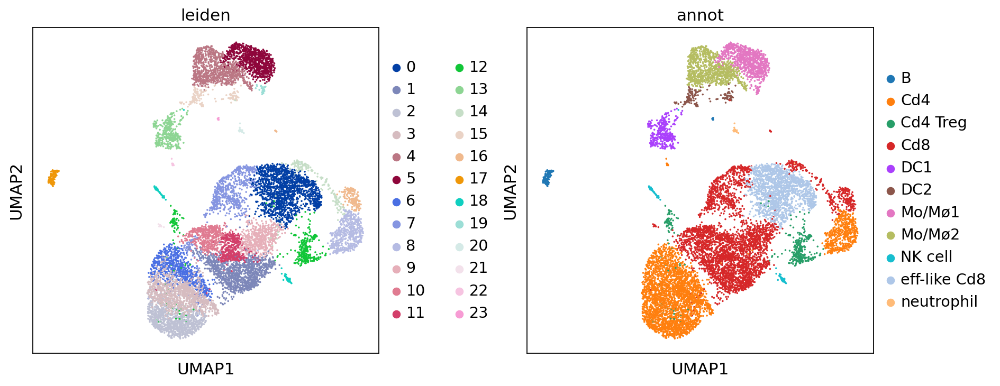

In [41]:
sc.set_figure_params(figsize=(5,5))
sc.pl.umap(wt_medln, color= ["leiden", "annot"], ncols = 3,
          vmin = "p2", vmax = "p98", wspace=0.3)

## now learn DEGs

In [42]:
from helper_functions_v2 import *

In [43]:
all_degs = new_lfcs(wt_medln, "raw_counts", "theta_1", "annot")

num genes with no counts in raw matrix: 0
(11558,)
0.05
(11846, 11558)
(1, 11558)
0.011733923107385635
B


/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/scipy/stats/_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: invalid value encountered in true_divide
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: divide by zero encountered in true_divide


  results: log2FC > 0.5: 730 genes; log2FC < -0.5: 500 genes
Cd4
  results: log2FC > 0.5: 1744 genes; log2FC < -0.5: 1813 genes
Cd4 Treg
  results: log2FC > 0.5: 954 genes; log2FC < -0.5: 285 genes
Cd8
  results: log2FC > 0.5: 515 genes; log2FC < -0.5: 1000 genes
DC1
  results: log2FC > 0.5: 1576 genes; log2FC < -0.5: 2216 genes
DC2
  results: log2FC > 0.5: 1384 genes; log2FC < -0.5: 1105 genes
Mo/Mø1
  results: log2FC > 0.5: 2099 genes; log2FC < -0.5: 2419 genes
Mo/Mø2
  results: log2FC > 0.5: 1827 genes; log2FC < -0.5: 2006 genes
NK cell


/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/scipy/stats/_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: invalid value encountered in true_divide
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: divide by zero encountered in true_divide


  results: log2FC > 0.5: 1146 genes; log2FC < -0.5: 186 genes
eff-like Cd8
  results: log2FC > 0.5: 1815 genes; log2FC < -0.5: 1812 genes
neutrophil


/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/scipy/stats/_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: invalid value encountered in true_divide
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: divide by zero encountered in true_divide


  results: log2FC > 0.5: 1495 genes; log2FC < -0.5: 559 genes


In [44]:
all_degs

,log2FC,cluster_means,noncluster_means,pval,padj,gene,cluster
2585,13.324034,4406.647949,0.417976,2.231557e-50,8.315832e-48,Cd19,B
2298,12.571222,30171.902344,4.946054,1.647031e-80,1.043394e-76,Cd79a,B
1208,11.989549,1464.098022,0.348314,4.230650e-36,7.444769e-34,Pax5,B
5230,11.876554,13664.915039,3.622462,1.100663e-74,2.324234e-71,Iglc2,B
194,11.862357,7306.136230,1.950556,6.630262e-50,2.210669e-47,Fcmr,B
...,...,...,...,...,...,...,...
3179,-14.760853,0.000000,325.751953,7.322799e-01,7.905111e-01,Idh3a,neutrophil
3703,-14.844907,0.000000,345.295380,3.765152e-01,4.604893e-01,Shmt2,neutrophil
5880,-14.866102,0.000000,350.405884,9.625491e-02,1.564846e-01,Snx2,neutrophil
1424,-14.908704,0.000000,360.907654,9.218853e-01,9.425909e-01,Rpa2,neutrophil


In [45]:
write_lfc_spreadsheet(all_degs, "ln.degs.by_annot.xls", sort_column = "log2FC")

/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:103: FutureWarning: As the xlwt package is no longer maintained, the xlwt engine will be removed in a future version of pandas. This is the only engine in pandas that supports writing in the xls format. Install openpyxl and write to an xlsx file instead. You can set the option io.excel.xls.writer to 'xlwt' to silence this warning. While this option is deprecated and will also raise a warning, it can be globally set and the warning suppressed.


## make better scale for biotin

In [46]:
fifth_pctile_biotin = np.quantile(wt_medln.obs["cell_norm_biotin"], 0.05)
wt_medln.obs["log normalized biotin"] = np.log10(wt_medln.obs["cell_norm_biotin"] + fifth_pctile_biotin)

In [47]:
wt_medln.obs["normalized biotin"] = wt_medln.obs["log normalized biotin"] - np.min(
    wt_medln.obs["log normalized biotin"])

In [48]:
## what we consider an acceptor of biotin
norm_biotin_pos_threshold = np.log10(8.5e-3 + fifth_pctile_biotin) - np.min(
    wt_medln.obs["log normalized biotin"])
norm_biotin_pos_threshold

1.1750912312740014

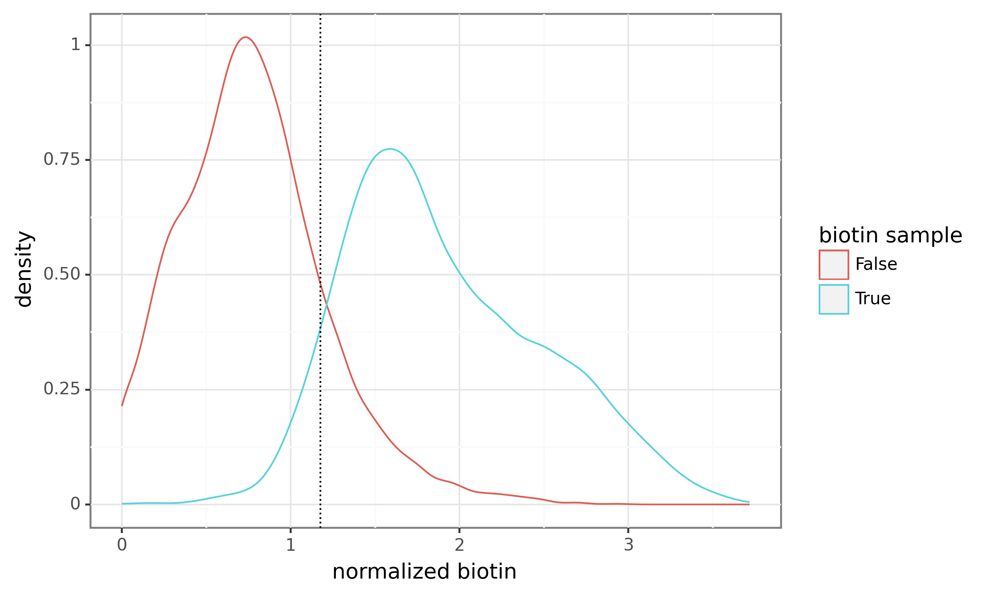

<ggplot: (8793235565882)>

In [49]:
ggplot(wt_medln.obs, aes(x="normalized biotin", color = "biotin sample")) + geom_density() + \
theme_bw() + theme(dpi = 200) + geom_vline(xintercept = norm_biotin_pos_threshold, linetype = "dotted")

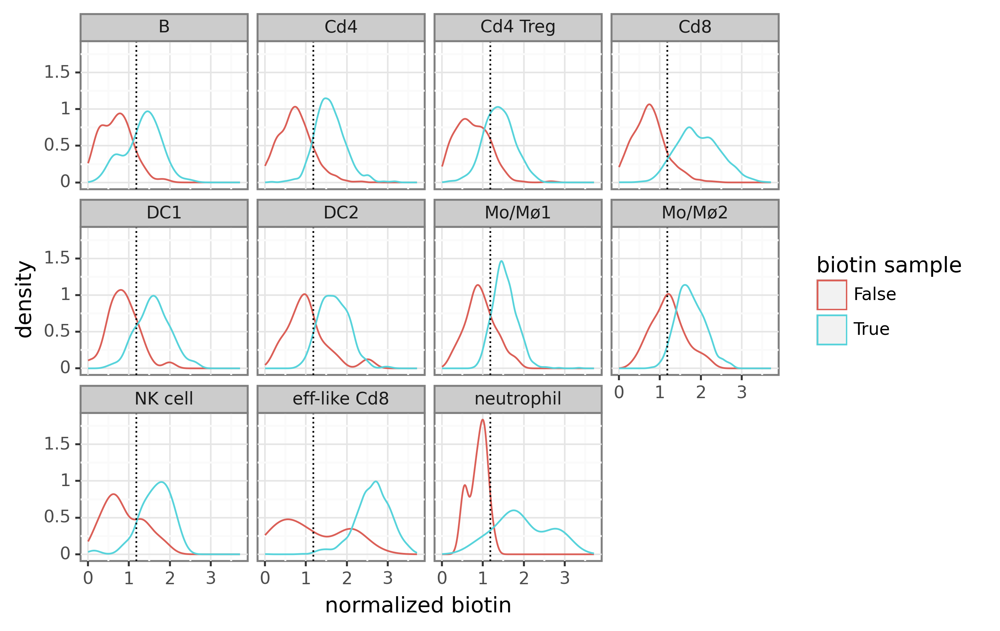

<ggplot: (8793400848122)>

In [50]:
ggplot(wt_medln.obs, aes(x="normalized biotin", color = "biotin sample")) + geom_density() + \
theme_bw() + theme(dpi = 200) + geom_vline(xintercept = norm_biotin_pos_threshold, linetype = "dotted") + \
facet_wrap("~ annot")

## determine which cells are donor based on (Cd8-based) donor level 

/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/pandas/core/arraylike.py:397: RuntimeWarning: divide by zero encountered in log10
/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/plotnine/layer.py:333: PlotnineWarning: stat_density : Removed 381 rows containing non-finite values.


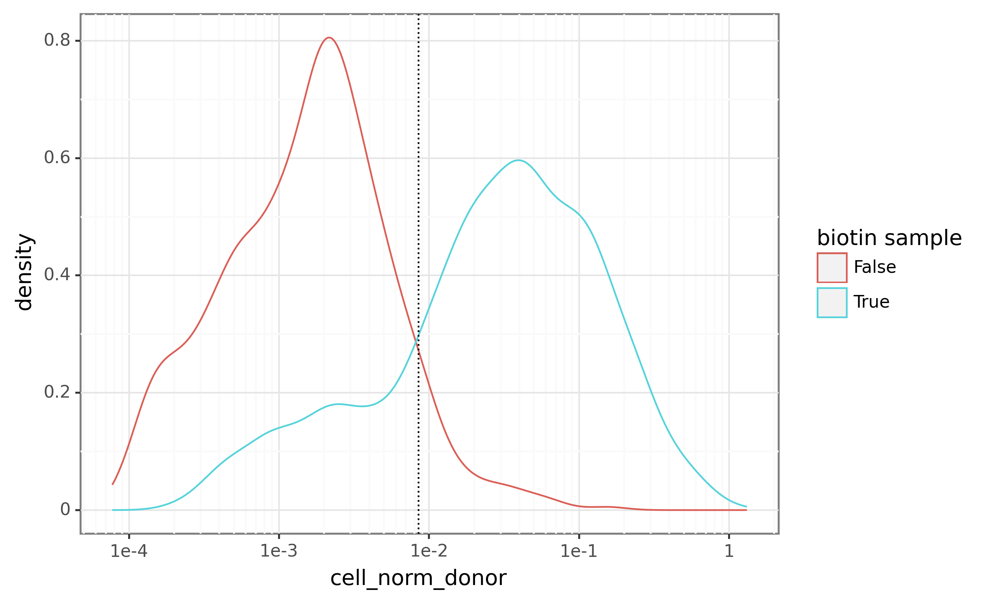

<ggplot: (8793233602783)>

In [51]:
ggplot(wt_medln.obs[wt_medln.obs["annot"].str.contains("Cd8")], aes(
    x="cell_norm_donor", color = "biotin sample")) + geom_density() + theme_bw() + theme(dpi = 200) + geom_vline(
    xintercept = 8.5e-3, linetype = "dotted") + scale_x_log10()

In [52]:
wt_medln.obs["donor"] =  (wt_medln.obs["cell_norm_donor"] >= 8e-3) # (wt_medln.obs.annot.str.contains("Cd8")) &

In [53]:
wt_medln.obs[" donor "] = wt_medln.obs["donor"].astype(str)

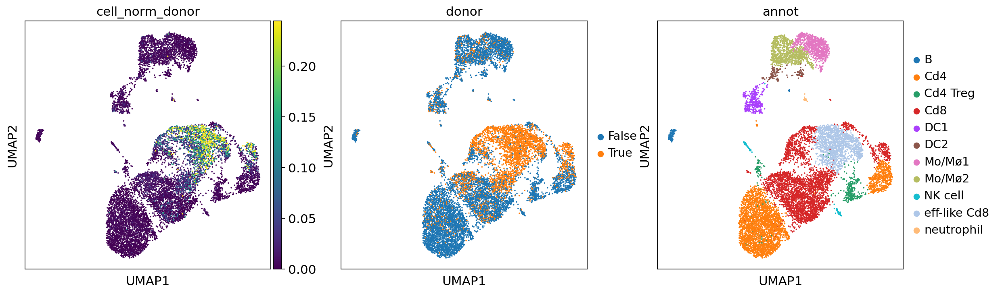

In [54]:
sc.pl.umap(wt_medln, color = ["cell_norm_donor", " donor ", "annot"], vmin = "p2", vmax = "p98")

In [55]:
norm_biotin_pos_threshold

1.1750912312740014

## interactors are **non donor cells** with high biotin levels

In [56]:
wt_medln.obs["interactor"] = (~wt_medln.obs["donor"]) & (
    wt_medln.obs["normalized biotin"] >= norm_biotin_pos_threshold)

In [57]:
wt_medln.obs[" interactor "] = wt_medln.obs["interactor"].astype(str)

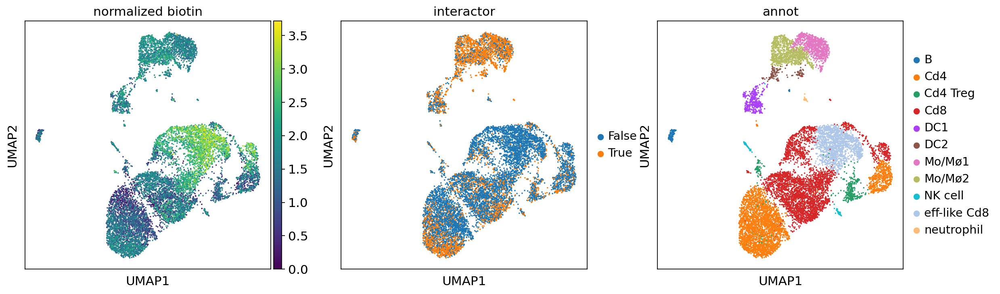

In [58]:
sc.pl.umap(wt_medln, color = ["normalized biotin", " interactor ", "annot"]) # , vmin = "p1", vmax = "p99")

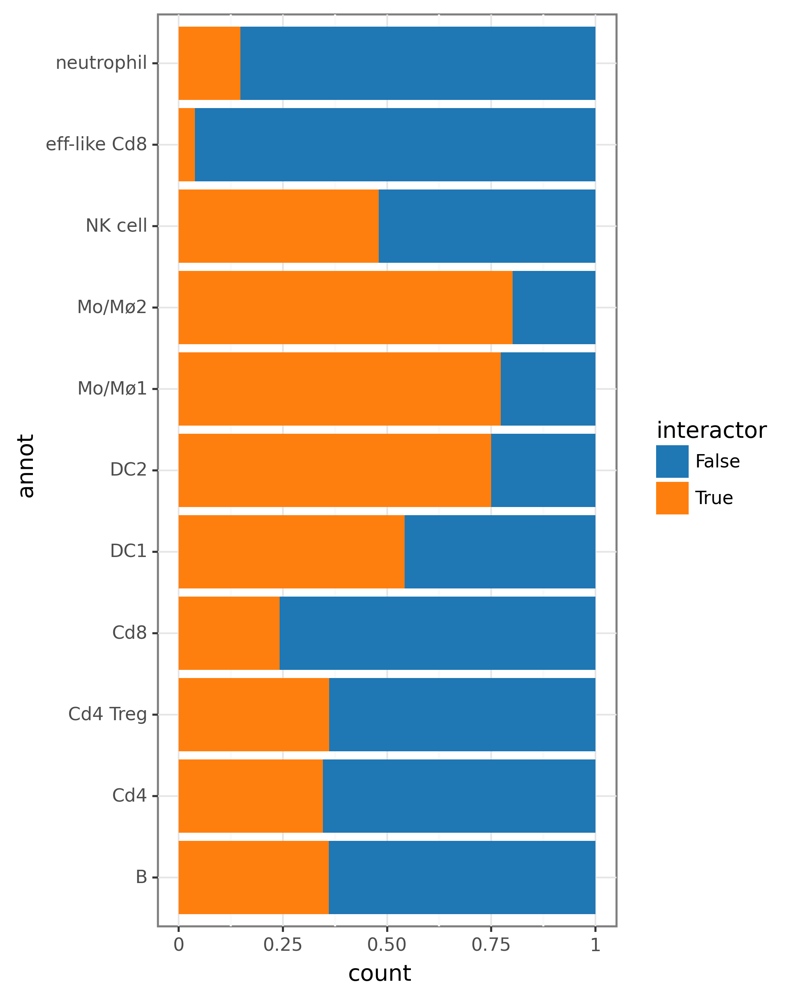

<ggplot: (8793233628956)>

In [59]:
ggplot(wt_medln.obs, aes(x="annot", fill = "interactor")) + geom_bar(position = "fill") + theme_bw() + \
theme(dpi = 200, figure_size=(4,8)) + scale_fill_manual(wt_medln.uns[" interactor _colors"]) + coord_flip()

## final figures 

In [60]:
color_cats = {"B": "#666666", "Cd4": "#00b8ad", "Cd4 Treg": "#009964", "Cd8": "#0a67b2", 
              "eff-like Cd8": "#00c0e8", "NK cell": "#92278f", "DC1": "#ffcc05", "DC2": "#f47920", 
              "Mo/Mø2": "#a82d25", "Mo/Mø1": "#ef4223", "neutrophil": "#f8a084"}
final_i = {i: ct for i,ct in enumerate(list(wt_medln.obs.sort_values(["annot"])["annot"].unique()))}
final_i      
colors_ordered = pd.DataFrame.from_dict(color_cats, orient="index").reset_index().merge(pd.DataFrame.from_dict(
    final_i, orient = "index").reset_index(), left_on = "index", right_on = 0).sort_values("index_y")
colors_ordered

,index,index_x,0_x,index_y,0_y
0,B,B,#666666,0,B
1,Cd4,Cd4,#00b8ad,1,Cd4
2,Cd4 Treg,Cd4 Treg,#009964,2,Cd4 Treg
3,Cd8,Cd8,#0a67b2,3,Cd8
6,DC1,DC1,#ffcc05,4,DC1
7,DC2,DC2,#f47920,5,DC2
9,Mo/Mø1,Mo/Mø1,#ef4223,6,Mo/Mø1
8,Mo/Mø2,Mo/Mø2,#a82d25,7,Mo/Mø2
5,NK cell,NK cell,#92278f,8,NK cell
4,eff-like Cd8,eff-like Cd8,#00c0e8,9,eff-like Cd8


In [61]:
wt_medln.uns["annot_colors"] = list(colors_ordered["0_x"])

##  <font color = "magenta"> Figure 5 Panel D, left

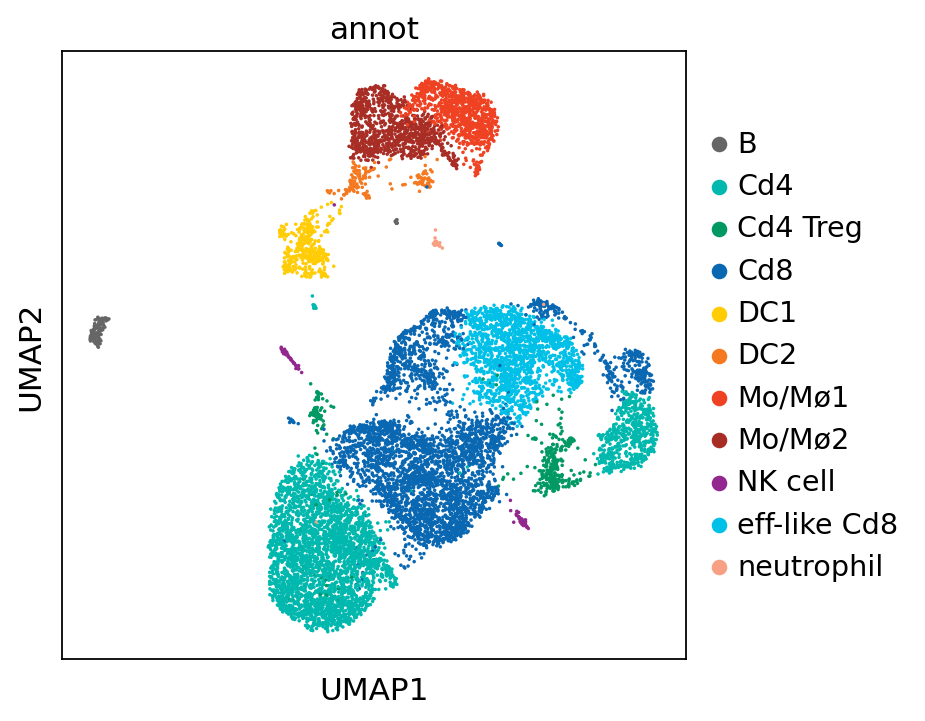

In [62]:
sc.pl.umap(wt_medln, color = "annot", save = ".panel_d1.all_cells.pdf")

In [63]:
wt_medln.obs[" normalized biotin "] = wt_medln.obs["normalized biotin"].copy()

In [64]:
wt_medln.obs.loc[wt_medln.obs["donor"], " normalized biotin "] = np.nan

##  <font color = "magenta"> Figure 5 Panel D, right

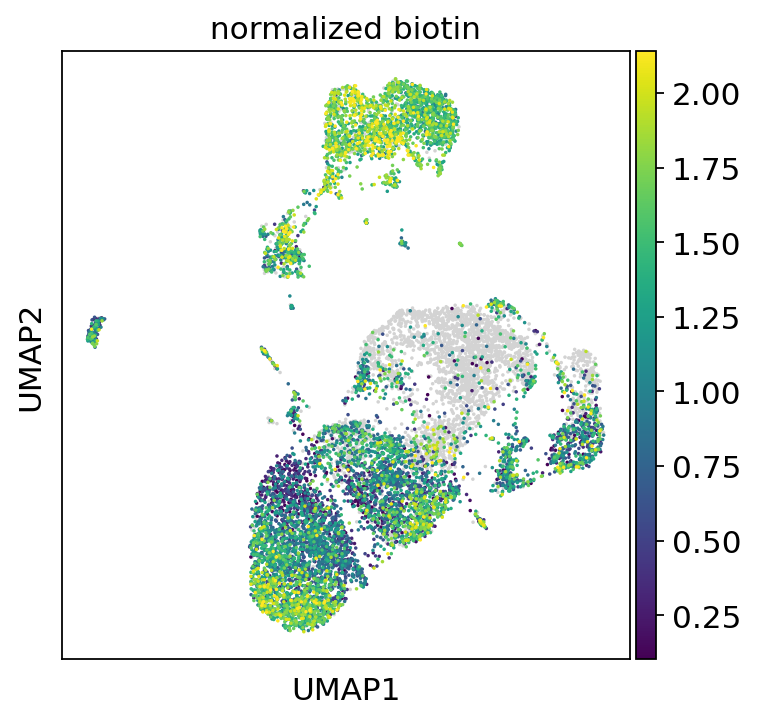

In [65]:
sc.pl.umap(wt_medln, color = [" normalized biotin "], vmin = "p2", vmax = "p98",
           save = ".panel_d2.all_cells.pdf", )

In [66]:
wt_medln[(~wt_medln.obs["donor"])].shape

(8268, 11558)

In [67]:
wt_medln[(~wt_medln.obs["donor"]) & (~wt_medln.obs["annot"].str.contains("Cd8"))].shape

(5950, 11558)

In [71]:
wt_medln.obs[" annot "] = wt_medln.obs["annot"].str.replace(" ", "\n")

In [72]:
reordered_annots = ['B', 'Cd4', 'Cd4 Treg', 'Cd8','eff-like Cd8', 'NK cell', 'DC1', 'DC2','Mo/Mø1', 'Mo/Mø2',
        'neutrophil']

In [73]:
wt_medln.obs[" annot "] = wt_medln.obs[" annot "].astype(pd.api.types.CategoricalDtype([
    s.replace(" ", "\n") for s  in reordered_annots], ordered=True))

In [74]:
wt_medln.uns[" annot _colors"] = [color_cats[s] for s in reordered_annots]

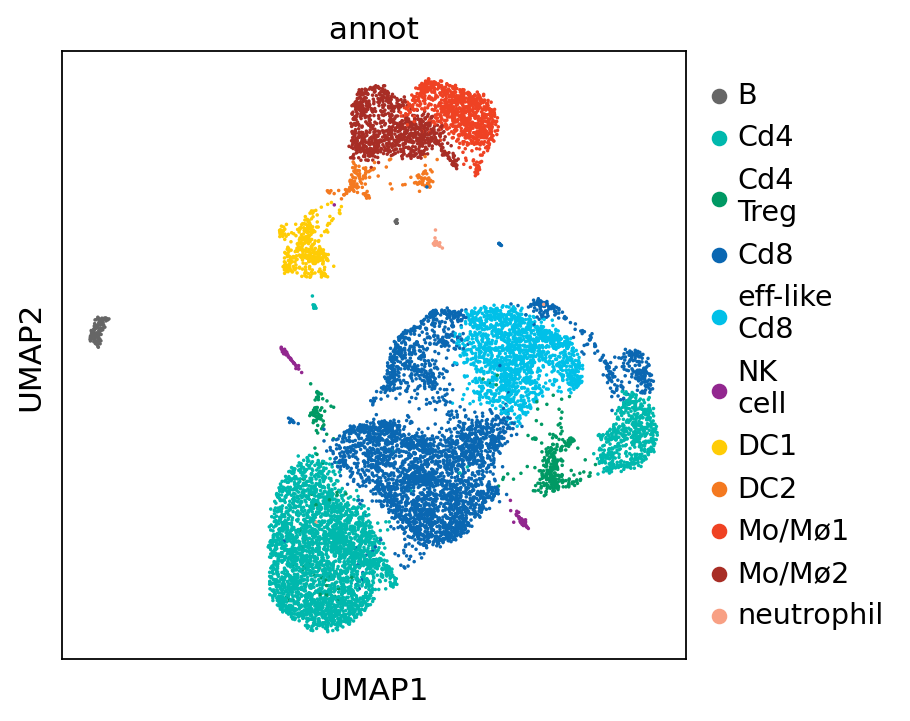

In [75]:
sc.pl.umap(wt_medln, color = " annot ")

## <font color = "magenta"> Figure 5 Panel E

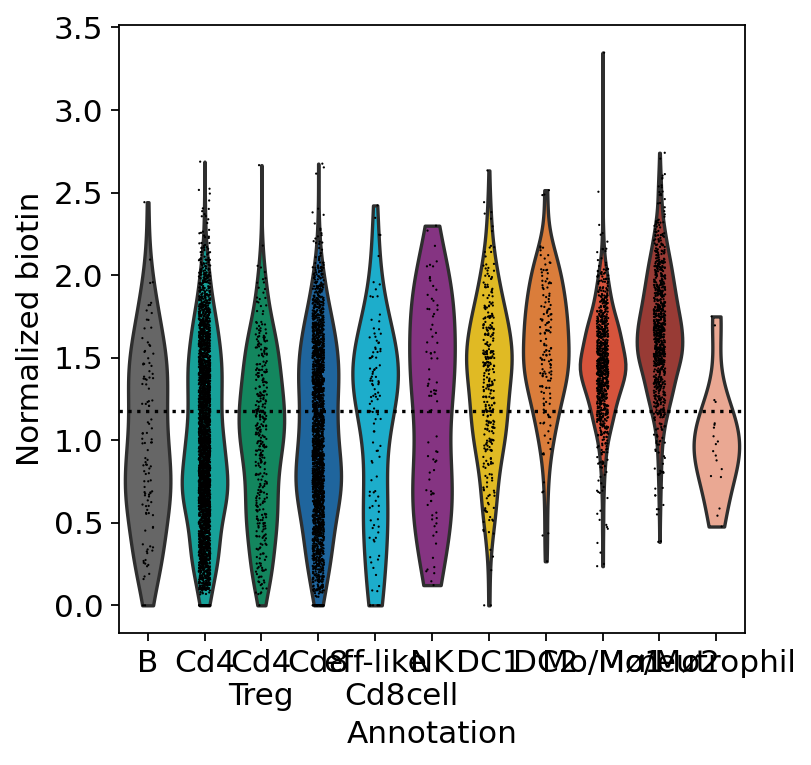

In [76]:
ax = sc.pl.violin(wt_medln[~wt_medln.obs["donor"]], keys = "normalized biotin", groupby=" annot ", ax = None,
                  show = False)
ax.grid(False)
ax.axhline(norm_biotin_pos_threshold, color = "black", linestyle="dotted")
plt.xlabel("Annotation")
plt.ylabel("Normalized biotin")
plt.savefig("figures/violin.panel_e1.excl_donors.pdf",  bbox_inches='tight')


## <font color = "blue"> Extended Data Figure 14 Panel G

Text(0, 0.5, 'Normalized biotin')

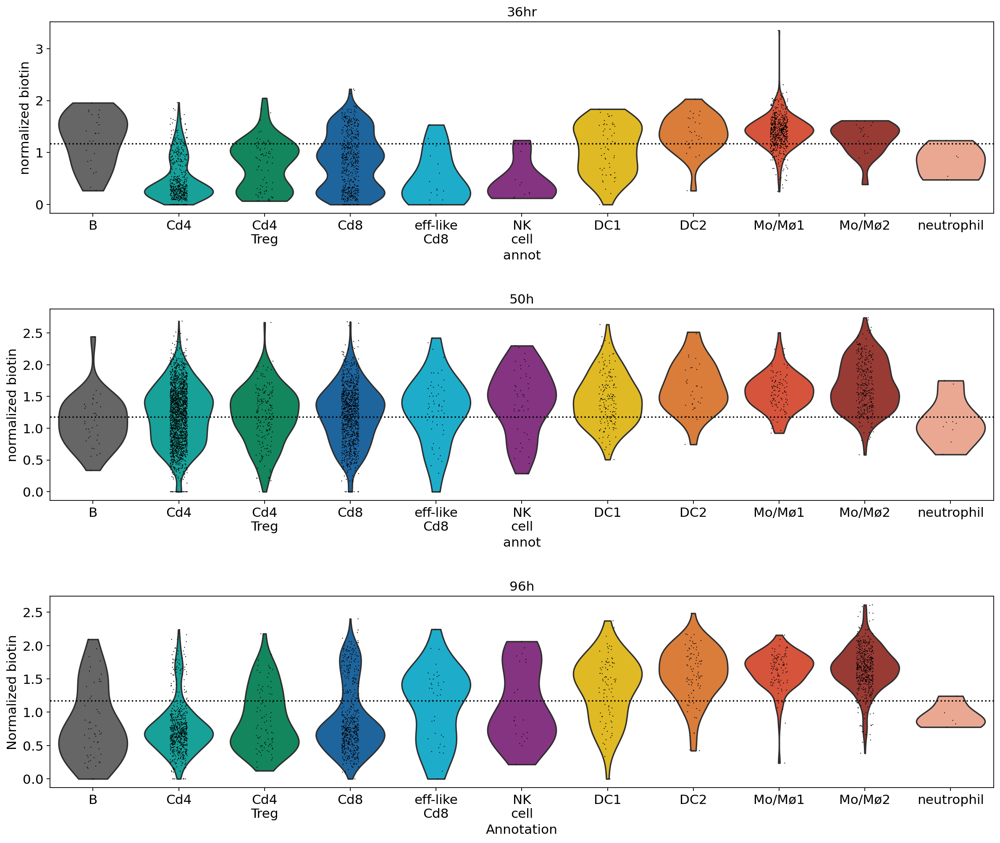

In [77]:
fig, axes = plt.subplots(3, 1, figsize=(18, 15), gridspec_kw={"hspace": 0.5})
for i, t in enumerate(["36hr", "50h", "96h"]):
    sc.pl.violin(wt_medln[(wt_medln.obs.timepoint == t) & (~wt_medln.obs.donor)], keys = "normalized biotin", 
                 groupby=" annot ", ax = axes[i], show = False, title = t)
    axes[i].grid(False)
    axes[i].title.set_text(t)
    axes[i].axhline(norm_biotin_pos_threshold, color = "black", linestyle="dotted")

plt.xlabel("Annotation")
plt.ylabel("Normalized biotin")
# fig.savefig("figures/violin.panel_e2.all_cells.pdf",  bbox_inches='tight')


In [78]:
sc.set_figure_params(figsize=(5,5), dpi_save=200, dpi = 200, vector_friendly=False)

In [79]:
wt_medln.obs[" interactor "] = ["interactor" if i else "not interacting" for i in wt_medln.obs["interactor"]]

##  <font color = "magenta"> Figure 5 Panel F

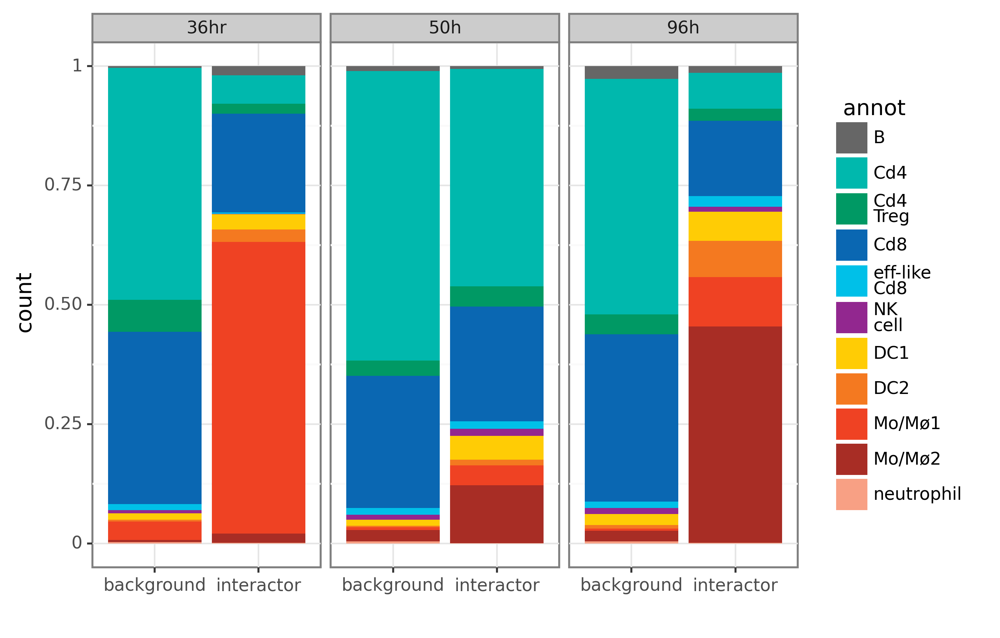

<ggplot: (8793401220551)>

In [80]:
p = ggplot(wt_medln[(~wt_medln.obs["donor"]) & (~wt_medln.obs["biotin sample"])].obs, aes(
    x="background", fill = " annot ")) + geom_bar(position = "fill") + geom_bar(wt_medln[(
    ~wt_medln.obs["donor"]) & (wt_medln.obs["interactor"])].obs, aes(x = " interactor "), position = "fill") + \
theme_bw() + theme(dpi = 200) + scale_fill_manual(wt_medln.uns[" annot _colors"]) + facet_wrap("~ timepoint") + \
labs(x=" ")
p

In [81]:
ggsave(p, "figures/panel_f.barplot.excl_donors.pdf", dpi = 200)

/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 6.4 x 4.8 in image.
/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/panel_f.barplot.excl_donors.pdf


In [82]:
wt_medln.obs["annot "] = [ "Cd8" if a == "eff-like Cd8" else a for a in wt_medln.obs.annot]

In [83]:
sc.settings.figdir = "supplemental_figures/"

In [84]:
sc.set_figure_params(figsize=(5,5), dpi=200, dpi_save=200, vector_friendly=False)

In [85]:
cl_degs = new_lfcs(wt_medln, "raw_counts", "theta_1", cl_level = "leiden", pseudocount_threshold = 0.05, cl_pct = 0.15,
              padj_threshold = 0.05, log2FC_threshold = 0.5, alt = "two-sided")

num genes with no counts in raw matrix: 0
(11558,)
0.05
(11846, 11558)
(1, 11558)
0.011733923107385635
0
  results: log2FC > 0.5: 1815 genes; log2FC < -0.5: 1812 genes
1
  results: log2FC > 0.5: 862 genes; log2FC < -0.5: 1358 genes
10


/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/scipy/stats/_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: invalid value encountered in true_divide
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: divide by zero encountered in true_divide


  results: log2FC > 0.5: 672 genes; log2FC < -0.5: 1109 genes
11


/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/scipy/stats/_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: invalid value encountered in true_divide
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: divide by zero encountered in true_divide


  results: log2FC > 0.5: 758 genes; log2FC < -0.5: 1210 genes
12
  results: log2FC > 0.5: 954 genes; log2FC < -0.5: 285 genes
13
  results: log2FC > 0.5: 1576 genes; log2FC < -0.5: 2216 genes
14
  results: log2FC > 0.5: 871 genes; log2FC < -0.5: 629 genes
15
  results: log2FC > 0.5: 1384 genes; log2FC < -0.5: 1105 genes
16
  results: log2FC > 0.5: 2443 genes; log2FC < -0.5: 1543 genes
17


/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/scipy/stats/_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: invalid value encountered in true_divide
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: divide by zero encountered in true_divide


  results: log2FC > 0.5: 1119 genes; log2FC < -0.5: 398 genes
18


/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/scipy/stats/_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: invalid value encountered in true_divide
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: divide by zero encountered in true_divide


  results: log2FC > 0.5: 1146 genes; log2FC < -0.5: 186 genes
19


/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/scipy/stats/_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: invalid value encountered in true_divide
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: divide by zero encountered in true_divide


  results: log2FC > 0.5: 1062 genes; log2FC < -0.5: 1042 genes
2


/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/scipy/stats/_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: invalid value encountered in true_divide
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: divide by zero encountered in true_divide


  results: log2FC > 0.5: 1238 genes; log2FC < -0.5: 1264 genes
20


/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/scipy/stats/_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: invalid value encountered in true_divide
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: divide by zero encountered in true_divide


  results: log2FC > 0.5: 1495 genes; log2FC < -0.5: 559 genes
21


/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/scipy/stats/_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: invalid value encountered in true_divide
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: divide by zero encountered in true_divide


  results: log2FC > 0.5: 144 genes; log2FC < -0.5: 96 genes
22


/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/scipy/stats/_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: invalid value encountered in true_divide
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: divide by zero encountered in true_divide


  results: log2FC > 0.5: 355 genes; log2FC < -0.5: 73 genes
23


/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/scipy/stats/_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: invalid value encountered in true_divide
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: divide by zero encountered in true_divide


  results: log2FC > 0.5: 804 genes; log2FC < -0.5: 2482 genes
3
  results: log2FC > 0.5: 1311 genes; log2FC < -0.5: 1274 genes
4
  results: log2FC > 0.5: 1827 genes; log2FC < -0.5: 2006 genes
5
  results: log2FC > 0.5: 2102 genes; log2FC < -0.5: 2413 genes
6


/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/scipy/stats/_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: invalid value encountered in true_divide
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: divide by zero encountered in true_divide


  results: log2FC > 0.5: 1391 genes; log2FC < -0.5: 1293 genes
7
  results: log2FC > 0.5: 1899 genes; log2FC < -0.5: 2082 genes
8


/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/scipy/stats/_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: invalid value encountered in true_divide
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: divide by zero encountered in true_divide


  results: log2FC > 0.5: 2386 genes; log2FC < -0.5: 2192 genes
9


/Genomics/argo/users/skwalker/scvi/lib/python3.9/site-packages/scipy/stats/_stats_py.py:279: RuntimeWarning: divide by zero encountered in log
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: invalid value encountered in true_divide
/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:29: RuntimeWarning: divide by zero encountered in true_divide


  results: log2FC > 0.5: 840 genes; log2FC < -0.5: 1213 genes


In [86]:
cl_degs

,log2FC,cluster_means,noncluster_means,pval,padj,gene,cluster
4754,4.142359,17264.820312,977.648926,1.592634e-244,1.193193e-243,1500009L16Rik,0
6079,3.810214,2558.137939,182.351456,6.934272e-18,9.743577e-18,Mxd3,0
6242,3.426559,16319.875977,1517.807617,4.818263e-98,1.260393e-97,Gzmk,0
4261,3.203324,14128.491211,1533.897461,0.000000e+00,0.000000e+00,Ccnb2,0
7199,3.184192,2590.767334,285.019928,3.105984e-60,6.253779e-60,Paqr4,0
...,...,...,...,...,...,...,...
6435,-9.142244,4.496490,2547.376953,3.594309e-126,4.326895e-124,Cybb,9
2720,-9.359101,4.496490,2960.561279,2.691034e-44,1.535977e-43,Nupr1,9
4773,-16.378078,0.000000,999.381287,3.758014e-122,3.949494e-120,Syk,9
2363,-17.540340,0.000000,2236.710449,7.476515e-93,2.591728e-91,Pirb,9


In [87]:
cl_degs["possible annot"] = [ annot_cl(cl) for cl in cl_degs["cluster"]]

In [88]:
cl_degs[" cluster "] = cl_degs["cluster"] + "   " + cl_degs["possible annot"]

In [90]:
write_lfc_spreadsheet(cl_degs, out_name = "ln_degs.xls", sort_column = "log2FC", sheet_name_col=" cluster ")

/Genomics/pritykinlab/sarah/lipstic_analysis/ulipstic-analysis/helper_functions_v2.py:103: FutureWarning: As the xlwt package is no longer maintained, the xlwt engine will be removed in a future version of pandas. This is the only engine in pandas that supports writing in the xls format. Install openpyxl and write to an xlsx file instead. You can set the option io.excel.xls.writer to 'xlwt' to silence this warning. While this option is deprecated and will also raise a warning, it can be globally set and the warning suppressed.


## <font color = "blue"> Extended Data Figure 14 Panel D

(24, 6484)
(23, 4)


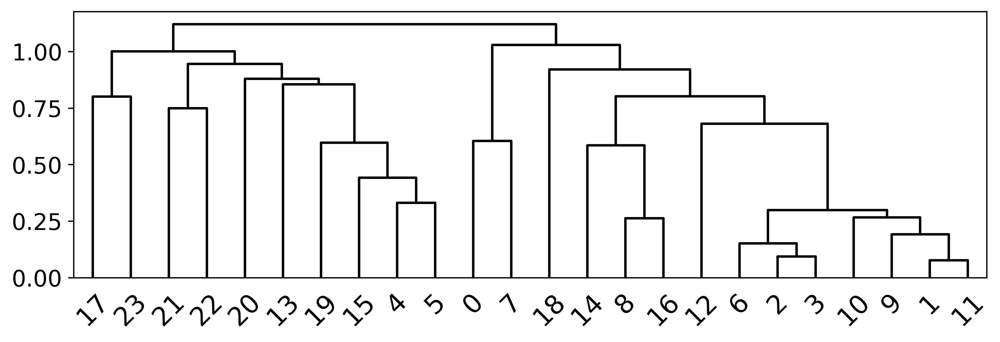

In [93]:
make_dendrogram(cl_degs[(cl_degs["padj"] <= 0.01) & (cl_degs["log2FC"] >= 1)]["gene"].unique(), wt_medln,
                  lay = "theta_1", out_name="dendrogram.ln_clusters.pdf")

## <font color = "blue"> Extended Data Figure 14 Panel E

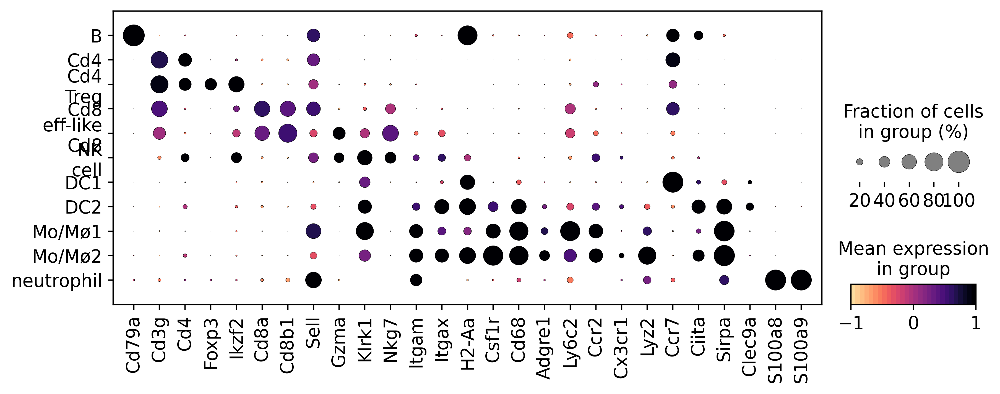

In [94]:
# sc.set_figure_params(figsize=(5,5))
sc.pl.dotplot(wt_medln, var_names = ["Cd79a", "Cd3g", "Cd4", "Foxp3", "Ikzf2", "Cd8a", "Cd8b1", "Sell", "Gzma", 
                                     "Klrk1", "Nkg7", "Itgam", "Itgax",  "H2-Aa", "Csf1r", "Cd68", "Adgre1", "Ly6c2",
                                     "Ccr2", "Cx3cr1", "Lyz2","Ccr7", "Ciita", "Sirpa", "Clec9a", "S100a8", "S100a9"],
              groupby = " annot ", layer="theta_1", cmap = magma_cmap, figsize=(10, 3.5), norm = mpl.colors.Normalize(
                  vmin=-1, vmax=1), save = "ln_annot_genes.pdf")

## <font color = "blue"> Extended Data Figure 14 Panel F

In [95]:
## have to plot 2x, because neutrophil population is so small can't see S100a8 gene with vmin/vmax thresholds 
## (but they make everything else much cleaner)
sc.pl.umap(wt_medln, color = ["Cd79a", "Cd3g", "Cd4", "Foxp3", "Cd8a", "Cd8b1", "Sell", "Tcf7", "Klrk1", "Itgam", 
                              "Itgax", "Ccr7", "Sirpa", "Ciita", "Clec9a", "Ly6c2", "Lyz2"], layer="theta_1", 
           vmin = "p0.5", vmax ="p99.5", cmap = magma_cmap, frameon = False, save = ".ln_gene_umaps_v1.pdf")

sc.pl.umap(wt_medln, color = ["Cd79a", "Cd3g", "Cd4", "Foxp3", "Cd8a", "Cd8b1", "Sell", "Tcf7", "Klrk1", "Itgam",
                              "Itgax", "Ccr7", "Sirpa", "Ciita", "Clec9a", "Ly6c2", "S100a8"], layer="theta_1", 
           cmap = magma_cmap, frameon = False,save = ".ln_gene_umaps_v2.pdf")


## help annotate tissue dataset

In [96]:
mean_profiles = pd.DataFrame(wt_medln.layers["theta_1"], columns = wt_medln.var_names, 
                             index = wt_medln.obs["annot"]).reset_index().groupby("annot").mean()    

In [97]:
mean_profiles.head()

,Mrpl15,Lypla1,Tcea1,Atp6v1h,Rb1cc1,St18,Pcmtd1,Rrs1,Mybl1,Vcpip1,...,AC125149.2,AC133103.1,AC168977.2,AC168977.1,CAAA01118383.1,Csprs,Vamp7,Tmlhe,CAAA01147332.1,AC149090.1
annot,,,,,,,,,,,,,,,,,,,,,
B,-0.289451,-0.242443,0.122113,0.010685,0.148287,-0.079925,0.701388,-0.024084,-0.066467,0.106349,...,0.379854,2.737383,0.701239,-0.005576,0.048989,0.415337,-0.058623,-0.177987,-0.485591,0.697637
Cd4,-0.191536,-0.084718,-0.095107,-0.038626,0.333259,-0.064662,0.279184,-0.184149,-0.085822,0.199784,...,-0.006707,-0.030502,-0.050812,-0.015075,-0.024660,-0.060327,-0.084650,0.444880,-0.543942,0.268052
Cd4 Treg,-0.135395,-0.031093,-0.018789,-0.062992,0.201301,-0.044978,0.325739,-0.101114,-0.075497,0.199435,...,-0.089625,-0.058439,0.089128,-0.074894,0.049245,-0.014873,-0.009234,0.283419,-0.203974,0.851729
Cd8,0.027201,-0.067754,-0.082873,-0.057704,0.068744,-0.050453,0.079397,0.148221,-0.075547,0.060982,...,-0.078389,-0.069211,-0.058414,-0.005848,-0.028091,-0.103560,-0.107240,0.169957,-0.469148,0.196295
DC1,-0.315269,-0.150677,-0.081169,-0.055462,-0.057952,0.343145,0.226676,-0.337395,-0.101465,-0.126871,...,1.206183,0.423368,0.280678,0.194479,0.032578,0.383805,-0.036324,-0.240315,1.931588,0.501892


In [98]:
mean_profiles.to_csv("mean_ln_profiles.csv")

## save AnnData

In [99]:
wt_medln.write_h5ad('final_wt_medln.h5ad')